In [57]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as num

# Ignore all warnings
import warnings
warnings.filterwarnings("ignore")

In [3]:
# Read FAO Food Loss csv files
food_loss_data = "../Resources/FAO_Food_Loss.csv"
food_loss = pd.read_csv(food_loss_data)
food_loss = pd.DataFrame(food_loss)
# Filter out the empty columns
food_loss_df = food_loss[["m49_code", "country", "region", "commodity", "year", "loss_percentage", "loss_percentage_original", 
                          "loss_quantity", "activity1", "activity2", "food_supply_stage", "treatment", "cause_of_loss"]]
food_loss_df.head()

,m49_code,country,region,commodity,year,loss_percentage,loss_percentage_original,loss_quantity,activity1,activity2,food_supply_stage,treatment,cause_of_loss
0,104,Myanmar,NaN,"Rice, milled",2015,1.78,1.78%,26.12kgs,Storage,NaN,Storage,"30 days storage, with trapping",Rodents
1,104,Myanmar,NaN,"Rice, milled",2015,11.77,11.77%,88.18kgs,Storage,NaN,Storage,"60 days storage, no trapping",Rodents
2,104,Myanmar,NaN,"Rice, milled",2015,5.88,5.88%,44.09kgs,Storage,NaN,Storage,"30 days storage, no trapping",Rodents
3,104,Myanmar,NaN,"Rice, milled",2015,3.57,3.57%,52.24kgs,Storage,NaN,Storage,"60 days storage, with trapping",Rodents
4,104,Myanmar,NaN,"Rice, milled",2015,17.65,17.65%,132.27kgs,Storage,NaN,Storage,"90 days storage, no trapping",Rodents


In [5]:
# Food groups (commodity)
commodity = food_loss_df['commodity'].unique()
print(len(commodity))
commodity_counts = food_loss_df['commodity'].value_counts()
pd.set_option('display.max_rows', None)
print(commodity_counts)

147
commodity
Maize (corn)                                                                    5696
Rice                                                                            4501
Millet                                                                          3687
Sorghum                                                                         3486
Wheat                                                                           1965
Fonio                                                                            968
Barley                                                                           616
Potatoes                                                                         384
Tomatoes                                                                         364
Mangoes, guavas and mangosteens                                                  322
Cabbages                                                                         299
Cauliflowers and broccoli                          

In [7]:
# Create food groups by commodity
food_group = {
    'Fruits': ['Tomatoes', 'Cucumbers and gherkins', 'Bananas', 'Plantains and cooking bananas', 'Other fruits, n.e.c.',
           'Papayas', 'Pineapples', 'Pears', 'Apples', 'Oranges', 'Mangoes, guavas and mangosteens',
           'Cantaloupes and other melons', 'Avocados', 'Pomelos and grapefruits', 'Lemons and limes',
           'Tangerines, mandarins, clementines', 'Grapes', 'Other tropical and subtropical fruits, n.e.c.',
           'Strawberries', 'Wine', 'Other citrus fruit, n.e.c.', 'Coconuts, in shell', 'Raspberries', 'Olives',
           'Juice of citrus fruit n.e.c.', 'Juice of lemon', 'Raisins', 'Blueberries', 'Kiwi fruit', 
           'Grape juice', 'Apple juice', 'Cranberries', 'Plums, dried', 'Other stone fruits','Persimmons',
           'Orange juice', 'Pineapple juice', 'Juice of lemon', 'Watermelons', 'Dates', 'Figs', 'Cherries',
           'Plums and sloes', 'Apricots','Areca nuts', 'Peaches and nectarines', 'Other pome fruits', 'Grapefruit juice',
           'Hazelnuts, in shell', 'Walnuts, in shell', 'Cashew nuts, in shell',  'Almonds, in shell', 'Pistachios, in shell'],
    'Vegetables': ['Cauliflowers and broccoli', 'Potatoes', 'Cabbages' 'Eggplants (aubergines)', 'Pumpkins, squash and gourds',
               'Okra', 'Carrots and turnips', 'Green garlic', 'Leeks and other alliaceous vegetables',
               'Onions and shallots, green', 'Spinach', 'Yams', 'Other vegetables, fresh n.e.c.', 'Cassava, fresh',
               'Lettuce and chicory', 'Chillies and peppers, dry (<i>Capsicum</i> spp., <i>Pimenta</i> spp.), raw',
               'Pepper (<i>Piper</i> spp.), raw', 'Cassava, dry', 'Sweet potatoes', 'Artichokes', 'Asparagus',
               'Edible roots and tubers with high starch or inulin content, n.e.c., fresh', 'Flour of cassava', 'Tapioca of cassava',
               'Vegetable products, fresh or dry n.e.c.', 'Sweet corn, frozen', 'Canned mushrooms',
               'Chillies and peppers, green (<i>Capsicum</i> spp. and <i>Pimenta</i> spp.)', 'Mushrooms and truffles',
               'Sweet corn, prepared or preserved', 'Sugar beet', 'Swedes, for forage',
               'Edible roots and tubers with high starch or inulin content, n.e.c., dry',
               'Other stimulant, spice and aromatic crops, n.e.c.'],
    'Dairy': ['Raw milk of cattle', 'Hen eggs in shell, fresh', 'Dairy products n.e.c.', 'Cheese from whole cow milk', 'Eggs, dried'],
    'Protein': ['Meat of cattle with the bone, fresh or chilled', 'Cattle', 'Eggs, dried','Meat of chickens, fresh or chilled',
            'Snails, fresh, chilled, frozen, dried, salted or in brine, except sea snails', 'Meat of goat, fresh or chilled', 'Camels',
            'Meat of goat, fresh or chilled (indigenous)', 'Sheep', 'Goats', 'Meat of pig with the bone, fresh or chilled',
            'Meat of sheep, fresh or chilled','Pig meat, cuts, salted, dried or smoked (bacon and ham)'],
    'Grains': ['Rice, milled', 'Rice', 'Wheat', 'Maize (corn)', 'Sorghum', 'Millet', 'Mixed grain', 'Fonio','Quinoa', 'Oats',
           'Broad beans and horse beans, green', 'Flour of triticale', 'Rye', 'Mustard seed', 'Safflower seed',
           'Uncooked pasta, not stuffed or otherwise prepared', 'Green corn (maize)', 'Sugar cane','Rape or colza seed',
           'Cottonseed', 'Sunflower seed', 'Soya bean oil', 'Sunflower-seed oil, crude','Sesame seed','Flour of buckwheat',
           'Anise, badian, coriander, cumin, caraway, fennel and juniper berries, raw','Cocoa beans', 'Sugar and syrups n.e.c.'],
    'Legumes': ['Beans, dry', 'Other beans, green', 'Peas, green', 'Peas, dry', 'Barley', 'Cow peas, dry', 'Groundnuts, shelled',
            'Broad beans and horse beans, dry' 'Lentils, dry', 'Soya beans', 'Groundnuts, excluding shelled', 'Other pulses n.e.c.',
           'Chick peas, dry', 'Other legumes, for forage', 'Bambara beans, dry', 'Pigeon peas, dry']}

In [9]:
# Add food_group into data frame
food_loss_df['food_group'] = food_loss_df['commodity'].map({commodity: group for group, commodities in food_group.items() for commodity in commodities})

# Count food group total
food_group_count = food_loss_df['food_group'].value_counts()
print(food_group_count)

food_group
Grains        20685
Fruits         3085
Vegetables     2129
Legumes        1216
Dairy           147
Protein          75
Name: count, dtype: int64


In [11]:
# Group contries (147) into corresponding continent
continent = {
    'Asia': ['Myanmar', 'Burundi','Central Asia', 'Sri Lanka', 'Western Asia', 'China', 'Palestine', 'Azerbaijan', 'Southern Asia', 
             'South-Eastern Asia', 'India', 'Indonesia', 'Iran (Islamic Republic of)', 'Kazakhstan', 'Jordan', 'Malaysia', 'Mali', 
             "Democratic People's Republic of Korea", 'Republic of Korea', "Lao People's Democratic Republic", 'Mauritania', 'Bahrain', 
             'Bangladesh', 'Armenia', 'Nepal', 'Oman', 'Pakistan', 'Philippines', 'Timor-Leste', 'Saudi Arabia', 'Serbia', 'Viet Nam', 
             'Turkey', 'Syrian Arab Republic', 'Thailand'],
    'Africa': ['Western Africa', 'Cambodia', 'Algeria', 'Cameroon', 'Chad', 'Northern Africa', 'Africa', 'Democratic Republic of the Congo',
               'Sub-Saharan Africa', 'Benin', 'Ethiopia', 'Eritrea', 'Angola', 'Gabon', 'Gambia', 'Ghana', 'Guinea', 'Haiti', "Côte d'Ivoire", 
               'Kenya', 'Lebanon', 'Lesotho', 'Liberia', 'Libya', 'Madagascar', 'Malawi', 'Morocco', 'Mozambique', 'Namibia', 'Niger', 'Nigeria', 
               'Guinea-Bissau', 'Rwanda', 'Senegal', 'Sierra Leone', 'South Sudan', 'Sudan', 'Eswatini', 'Togo', 'Tunisia', 'Egypt', 'Uganda',
               'Somalia', 'South Africa', 'Zimbabwe', 'Botswana', 'United Republic of Tanzania', 'Burkina Faso', 'Zambia'],
    'Americas': ['Canada', 'Cuba', 'Northern America', 'Mexico', 'Saint Kitts and Nevis', 'Saint Lucia', 'Trinidad and Tobago', 'Belize',
                 'United States of America', 'Costa Rica', 'Dominican Republic', 'El Salvador', 'Guatemala', 'Honduras', 'Nicaragua', 'Panama',
                 'Chile', 'Colombia', 'Ecuador', 'Argentina', 'Guyana', 'Latin America and the Caribbean', 'Paraguay', 'Peru', 
                 'Bolivia (Plurinational State of)', 'Brazil', 'Uruguay', 'Venezuela (Bolivarian Republic of)'],
    'Europe': ['Europe', 'Denmark', 'Finland', 'France', 'Germany', 'Italy', 'Norway', 'Sweden', 'Switzerland', 'Ukraine', 
               'United Kingdom of Great Britain and Northern Ireland'],
    'Australia': ['Fiji', 'Australia', 'Australia and New Zealand', 'New Zealand']}

In [13]:
# Add continent to data frame
food_loss_df['continent'] = food_loss_df['country'].map({country: group for group, countries in continent.items() for country in countries})
food_loss_df

,m49_code,country,region,commodity,year,loss_percentage,loss_percentage_original,loss_quantity,activity1,activity2,food_supply_stage,treatment,cause_of_loss,food_group,continent
0,104,Myanmar,NaN,"Rice, milled",2015,1.780000,1.78%,26.12kgs,Storage,NaN,Storage,"30 days storage, with trapping",Rodents,Grains,Asia
1,104,Myanmar,NaN,"Rice, milled",2015,11.770000,11.77%,88.18kgs,Storage,NaN,Storage,"60 days storage, no trapping",Rodents,Grains,Asia
2,104,Myanmar,NaN,"Rice, milled",2015,5.880000,5.88%,44.09kgs,Storage,NaN,Storage,"30 days storage, no trapping",Rodents,Grains,Asia
3,104,Myanmar,NaN,"Rice, milled",2015,3.570000,3.57%,52.24kgs,Storage,NaN,Storage,"60 days storage, with trapping",Rodents,Grains,Asia
4,104,Myanmar,NaN,"Rice, milled",2015,17.650000,17.65%,132.27kgs,Storage,NaN,Storage,"90 days storage, no trapping",Rodents,Grains,Asia
5,104,Myanmar,NaN,"Rice, milled",2015,5.350000,5.35%,78.36kgs,Storage,NaN,Storage,"90 days storage, with trapping",Rodents,Grains,Asia
6,104,Myanmar,NaN,Rice,1994,2.100000,2.1,NaN,NaN,NaN,Harvest,NaN,"Too Mature, Leading To Breakage",Grains,Asia
7,104,Myanmar,NaN,Rice,1994,0.500000,0.5,NaN,NaN,NaN,Farm,NaN,Field Stacking And Bundling,Grains,Asia
8,104,Myanmar,NaN,Rice,1994,2.100000,2.1,NaN,Harvesting,NaN,Harvest,NaN,Combine-Harvester,Grains,Asia
9,104,Myanmar,NaN,Rice,1994,5.400000,5.4,NaN,NaN,NaN,Harvest,NaN,Shoulder Power Reaper,Grains,Asia


In [14]:
# Count how many rows of data each country accounts for; how many each continent accounts for
country_group_count = food_loss_df['country'].value_counts()
print(country_group_count)

continent_group_count = food_loss_df['continent'].value_counts()
print(continent_group_count)

country
United States of America                                3094
India                                                   1354
Ethiopia                                                1064
Kenya                                                   1054
Uganda                                                   866
Ghana                                                    817
Malawi                                                   803
Senegal                                                  799
Zambia                                                   772
Burkina Faso                                             758
Angola                                                   726
Benin                                                    719
Mali                                                     626
United Republic of Tanzania                              603
Mozambique                                               595
Rwanda                                                   591
Bangladesh      

In [15]:
# Get the country with the highest food waste (highest loss percentage)
most_waste = food_loss_df.sort_values(by='loss_percentage', ascending=False)

country_with_most_waste = most_waste.iloc[0]['country']
continent_with_most_waste = most_waste.iloc[0]['continent']
food_group_most_waste = most_waste.iloc[0]['food_group']

print(f"Country with most waste: {country_with_most_waste}.")
print(f"Continent with most waste: {continent_with_most_waste}.")
print(f"Food group most wasted: {food_group_most_waste}.")

Country with most waste: Republic of Korea.
Continent with most waste: Asia.
Food group most wasted: Fruits.


In [19]:
most_wasted_per_country = food_loss_df.groupby('country').apply(lambda x: x.loc[x['loss_percentage'].idxmax()])
# Sort the DataFrame by loss_percentage in descending order
most_wasted_per_country_sorted = most_wasted_per_country.sort_values(by='loss_percentage', ascending=False)

# Print the most wasted food group per country
for index, row in most_wasted_per_country_sorted.iterrows():
    pd.set_option('display.max_rows', None)
    print(f"{row['country']} wasted the most {row['food_group']}.")

# FOR ONLY TOP 10
# Slice the DataFrame to select only the top 10 countries with the most wasted food groups
#top_10_countries = most_wasted_per_country_sorted.head(10)

# Print the most wasted food group per country for the top 10 countries
#for index, row in top_10_countries.iterrows():
    #print(f"{row['country']} wasted the most {row['food_group']}.")

Republic of Korea wasted the most Fruits.
Australia wasted the most Vegetables.
Nigeria wasted the most Legumes.
United States of America wasted the most Fruits.
United Republic of Tanzania wasted the most Fruits.
India wasted the most nan.
Viet Nam wasted the most Grains.
Uganda wasted the most Grains.
Benin wasted the most Vegetables.
Ghana wasted the most Legumes.
Kenya wasted the most Grains.
Trinidad and Tobago wasted the most Vegetables.
Burkina Faso wasted the most Grains.
Peru wasted the most Vegetables.
Nepal wasted the most Fruits.
China wasted the most Vegetables.
Guatemala wasted the most Grains.
Australia and New Zealand wasted the most Protein.
Haiti wasted the most Fruits.
Canada wasted the most Protein.
Zimbabwe wasted the most Legumes.
Costa Rica wasted the most Fruits.
Ethiopia wasted the most Fruits.
Mexico wasted the most nan.
Venezuela (Bolivarian Republic of) wasted the most Vegetables.
Armenia wasted the most Fruits.
Pakistan wasted the most Fruits.
United Kingdo

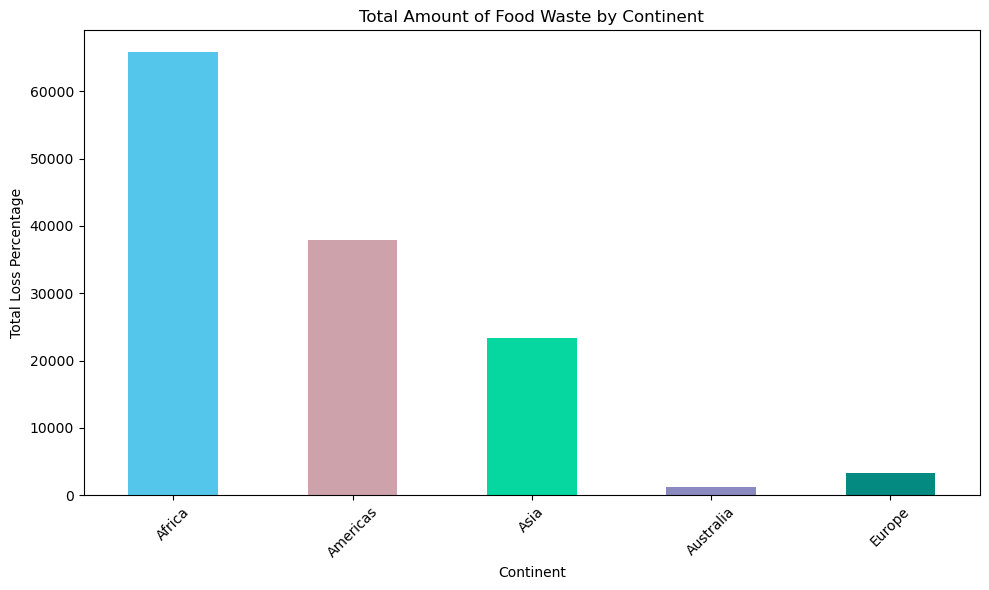

<Figure size 640x480 with 0 Axes>

In [21]:
continent_waste = food_loss_df.groupby('continent')['loss_percentage'].sum()
colors = {'Asia': '#06D6A0', 'Europe': '#048A81', 'Africa': '#54C6EB', 'Americas': '#CDA2AB', 'Australia': '#8A89C0'}

# Create a bar graph to visualize the total amount of food waste by continent
plt.figure(figsize=(10, 6))
continent_waste.plot(kind='bar', color=[colors[continent] for continent in continent_waste.index])
plt.title('Total Amount of Food Waste by Continent')
plt.xlabel('Continent')
plt.ylabel('Total Loss Percentage')
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()
plt.savefig('viz/waste_by_continent.png')

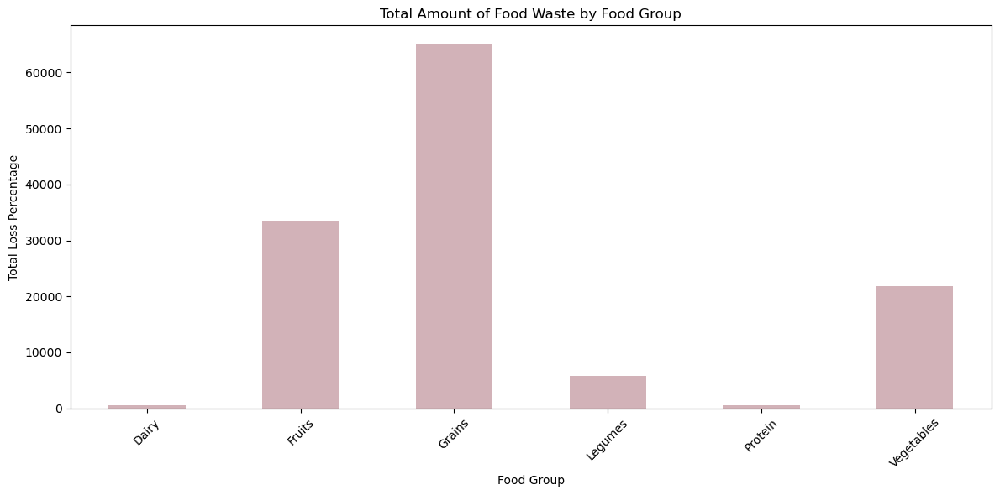

In [23]:
food_group_waste = food_loss_df.groupby('food_group')['loss_percentage'].sum()

# Create a bar graph to visualize the total amount of food waste by food group
plt.figure(figsize=(12, 6))
food_group_waste.plot(kind='bar', color='#D2B2B8')
plt.title('Total Amount of Food Waste by Food Group')
plt.xlabel('Food Group')
plt.ylabel('Total Loss Percentage')
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('viz/waste_by_food_group.png')

In [31]:
top_countries = food_loss_df.groupby('country')['loss_percentage'].sum().nlargest(10)
print(top_countries)

country
United States of America       33326.641906
Ghana                           4805.160200
India                           4720.159000
Kenya                           4519.156404
Bangladesh                      3943.736500
Benin                           3776.708030
Ethiopia                        3316.615616
United Republic of Tanzania     2791.422461
Uganda                          2568.179836
Senegal                         2503.636226
Name: loss_percentage, dtype: float64


<Figure size 1200x800 with 0 Axes>

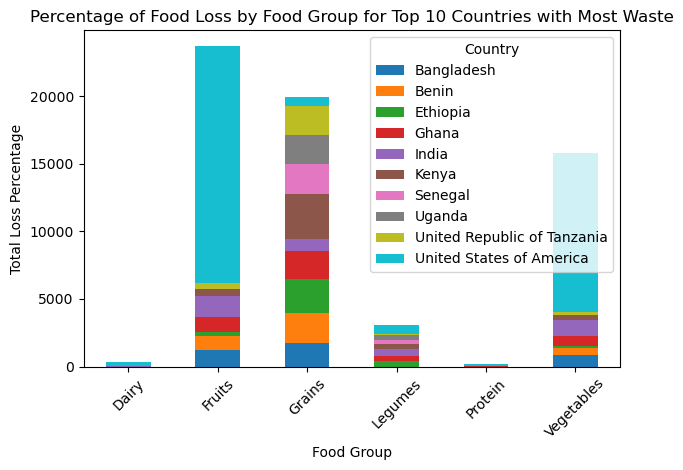

In [33]:
top_countries = food_loss_df.groupby('country')['loss_percentage'].sum().nlargest(10)
top_countries_data = food_loss_df[food_loss_df['country'].isin(top_countries.index)]

# Stacked Bar Chart
plt.figure(figsize=(12, 8))
top_countries_data.pivot_table(index='food_group', columns='country', values='loss_percentage', aggfunc='sum').plot(kind='bar', stacked=True)
plt.title('Percentage of Food Loss by Food Group for Top 10 Countries with Most Waste')
plt.xlabel('Food Group')
plt.ylabel('Total Loss Percentage')
plt.xticks(rotation=45)
plt.legend(title='Country')
plt.tight_layout()
plt.savefig('viz/food_group_waste_by_top_10_countries.png')

<Figure size 1200x800 with 0 Axes>

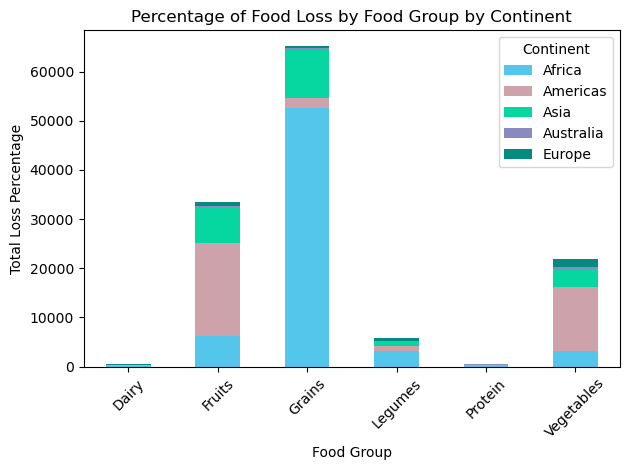

In [55]:
top_continents = food_loss_df.groupby('continent')['loss_percentage'].sum().nlargest(10)
top_continents_data = food_loss_df[food_loss_df['continent'].isin(top_continents.index)]
colors = {'Asia': '#06D6A0', 'Europe': '#048A81', 'Africa': '#54C6EB', 'Americas': '#CDA2AB', 'Australia': '#8A89C0'}
# Stacked Bar Chart
plt.figure(figsize=(12, 8))
top_continents_data.pivot_table(index='food_group', columns='continent', values='loss_percentage', aggfunc='sum').plot(kind='bar',color=[colors[continent] for continent in continent_waste.index], stacked=True)
plt.title('Percentage of Food Loss by Food Group by Continent')
plt.xlabel('Food Group')
plt.ylabel('Total Loss Percentage')
plt.xticks(rotation=45)
plt.legend(title='Continent')
plt.tight_layout()
plt.savefig('viz/food_group_waste_by_continent.png')